In [1]:
from nilearn import datasets
import nilearn
import nibabel



In [2]:
x = datasets.fetch_atlas_harvard_oxford('cort-maxprob-thr25-2mm')

[fetch_atlas_harvard_oxford] Dataset found in C:\Users\ducat\nilearn_data\fsl

In [3]:
x

{'maps': <nibabel.nifti1.Nifti1Image at 0x24b9828ecb0>,
 'labels': ['Background',
  'Frontal Pole',
  'Insular Cortex',
  'Superior Frontal Gyrus',
  'Middle Frontal Gyrus',
  'Inferior Frontal Gyrus, pars triangularis',
  'Inferior Frontal Gyrus, pars opercularis',
  'Precentral Gyrus',
  'Temporal Pole',
  'Superior Temporal Gyrus, anterior division',
  'Superior Temporal Gyrus, posterior division',
  'Middle Temporal Gyrus, anterior division',
  'Middle Temporal Gyrus, posterior division',
  'Middle Temporal Gyrus, temporooccipital part',
  'Inferior Temporal Gyrus, anterior division',
  'Inferior Temporal Gyrus, posterior division',
  'Inferior Temporal Gyrus, temporooccipital part',
  'Postcentral Gyrus',
  'Superior Parietal Lobule',
  'Supramarginal Gyrus, anterior division',
  'Supramarginal Gyrus, posterior division',
  'Angular Gyrus',
  'Lateral Occipital Cortex, superior division',
  'Lateral Occipital Cortex, inferior division',
  'Intracalcarine Cortex',
  'Frontal Medial

In [4]:
x["maps"]

C:\Python310\lib\site-packages\numpy\_core\fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


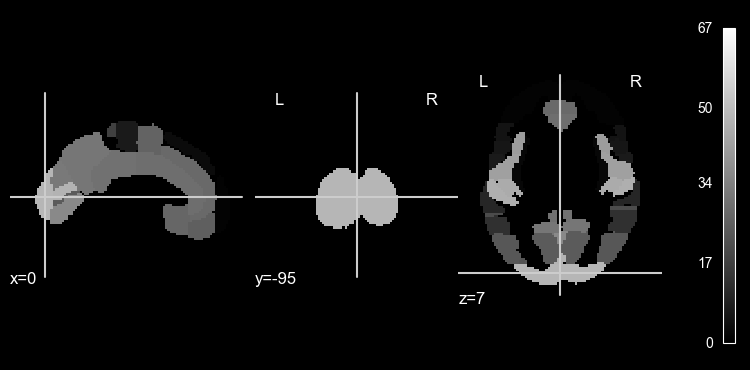

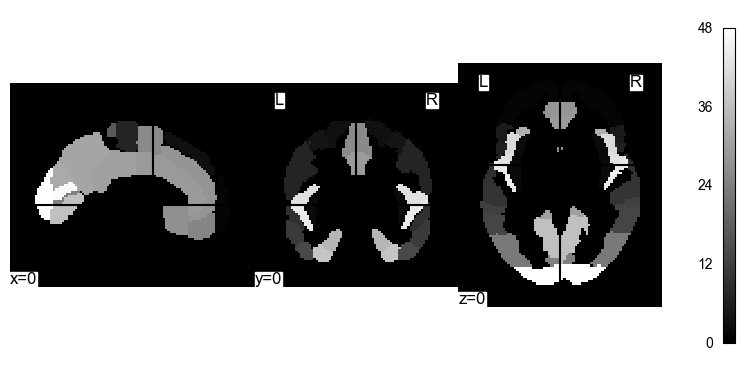

In [5]:
from nilearn import plotting
import nibabel as nib

# Quick view of anatomical image
plotting.view_img(x["maps"])

# Static plots
plotting.plot_anat(x["maps"])
plotting.show()

# Plot specific slice
plotting.plot_img(x["maps"], cut_coords=(0, 0, 0))
plotting.show()


In [6]:
x["maps"].shape

(91, 109, 91)

In [7]:
x["maps"].dataobj.shape

(91, 109, 91)

In [8]:
nibabel.load(
    "../Familiarity/sub-11/func/sub-11_task-morph_run-1_space-MNI152NLin2009cAsym_desc-preproc_denoised_bold.nii.gz")

In [9]:
x = nibabel.load(
    "../Familiarity/sub-11/func/sub-11_task-morph_run-1_space-MNI152NLin2009cAsym_desc-preproc_denoised_bold.nii.gz")

In [10]:
x.shape

(65, 77, 55, 204)

In [11]:

import matplotlib.pyplot as plt



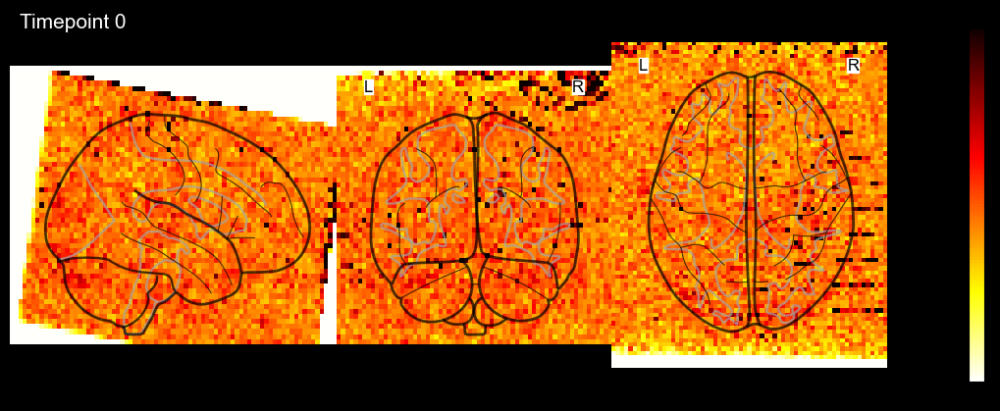

In [12]:
from nilearn import plotting, image
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(10, 4))

def animate(frame):
    plt.clf()
    vol = image.index_img(x, frame)
    plotting.plot_glass_brain(vol, threshold=None,
                             title=f'Timepoint {frame}',
                             figure=fig, colorbar=True)

ani = animation.FuncAnimation(fig, animate,
                             frames=20,
                             interval=200)

HTML(ani.to_jshtml())

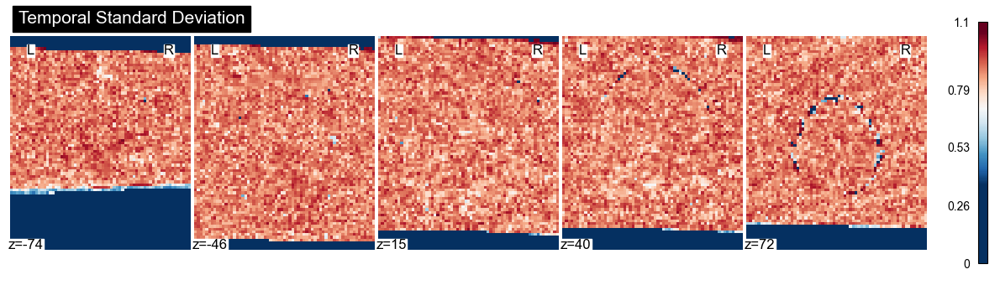

In [13]:
from nilearn import image, plotting
import numpy as np

# Calculate standard deviation across time
std_img = image.math_img('np.std(img, axis=3)', img=x)

plotting.plot_stat_map(std_img, title='Temporal Standard Deviation',
                       cut_coords=5, display_mode='z')
plt.show()


C:\Users\ducat\AppData\Local\Temp\ipykernel_4992\1694644083.py:4: FutureWarning: boolean values for 'standardize' will be deprecated in nilearn 0.15.0.
Use 'zscore_sample' instead of 'True' or use 'None' instead of 'False'.
  plotting.plot_carpet(x, mask_img=None, t_r=2.0)
C:\Users\ducat\AppData\Local\Temp\ipykernel_4992\1694644083.py:4: FutureWarning: The default strategy for standardize is currently 'zscore' which incorrectly uses population std to calculate sample zscores. The new strategy 'zscore_sample' corrects this behavior by using the sample std. In release 0.14.0, the default strategy will be replaced by the new strategy, the 'zscore' option will be removed. and using standardize=True will fall back to 'zscore_sample'.To avoid this warning, please use 'zscore_sample' instead.
  plotting.plot_carpet(x, mask_img=None, t_r=2.0)


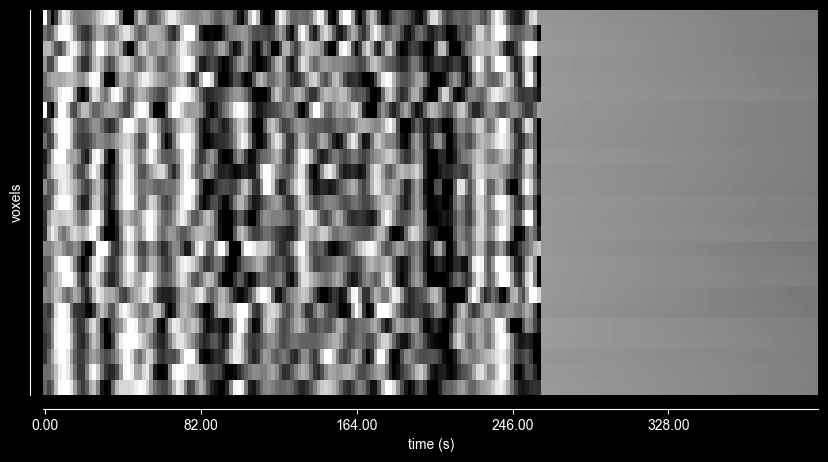

In [14]:
from nilearn import plotting

# Create carpet plot showing all voxels over time
plotting.plot_carpet(x, mask_img=None, t_r=2.0)
plt.show()


In [15]:
import matplotlib.pyplot as plt
from ipywidgets import interact
import nibabel as nib

data = x.get_fdata()

@interact(timepoint=(0, data.shape[3]-1),
          slice_idx=(0, data.shape[2]-1))
def view_4d(timepoint=0, slice_idx=None):
    if slice_idx is None:
        slice_idx = data.shape[2] // 2

    plt.figure(figsize=(10, 8))
    plt.imshow(data[:, :, slice_idx, timepoint].T, cmap='gray', origin='lower')
    plt.title(f'Timepoint: {timepoint}, Slice: {slice_idx}')
    plt.colorbar()
    plt.show()


interactive(children=(IntSlider(value=0, description='timepoint', max=203), IntSlider(value=27, description='s…

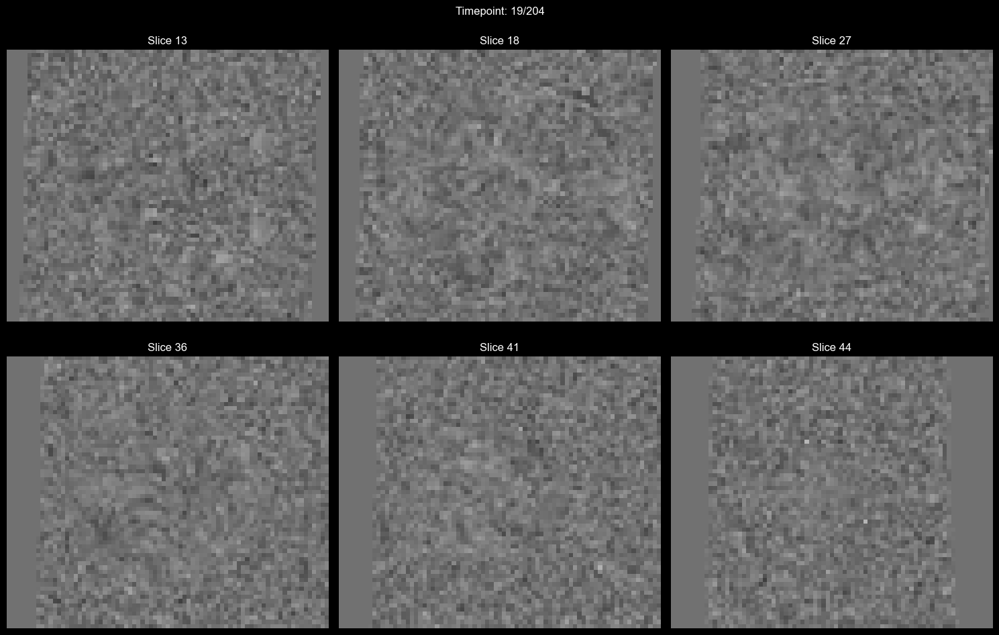

In [16]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

data = x.get_fdata()

fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes = axes.flatten()

slice_indices = [
    data.shape[2]//4, data.shape[2]//3, data.shape[2]//2,
    2*data.shape[2]//3, 3*data.shape[2]//4, 4*data.shape[2]//5
]

ims = []
for idx, ax in enumerate(axes):
    im = ax.imshow(data[:, :, slice_indices[idx], 0],
                   cmap='gray', vmin=data.min(), vmax=data.max())
    ax.set_title(f'Slice {slice_indices[idx]}')
    ax.axis('off')
    ims.append(im)

def update(frame):
    for idx, im in enumerate(ims):
        im.set_array(data[:, :, slice_indices[idx], frame])
    fig.suptitle(f'Timepoint: {frame}/{data.shape[3]}')
    return ims

ani = FuncAnimation(fig, update, frames=20,
                   interval=200, blit=True)
plt.tight_layout()
# plt.show()

HTML(ani.to_jshtml())


In [25]:
mask = nibabel.load(
    "../Familiarity/sub-11/func/sub-11_task-morph_run-1_space-MNI152NLin2009cAsym_desc-brain_mask.nii.gz")

In [29]:
mask.shape

(65, 77, 55)

C:\Python310\lib\site-packages\numpy\_core\fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
C:\Users\ducat\AppData\Local\Temp\ipykernel_21856\2933883087.py:5: UserWarning: Resampling binary images with continuous or linear interpolation. This might lead to unexpected results. You might consider using nearest interpolation instead.
  plotting.view_img(mask)


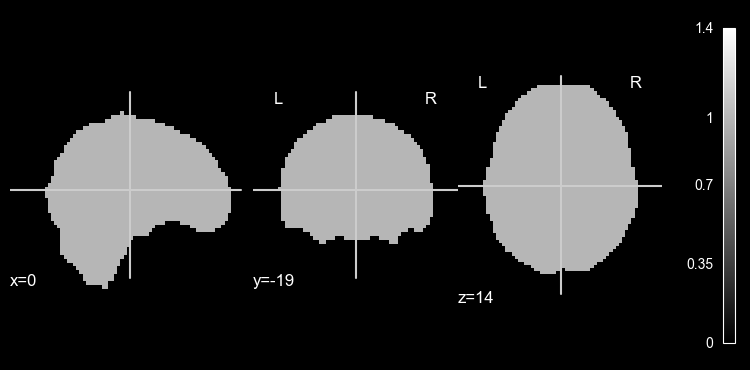

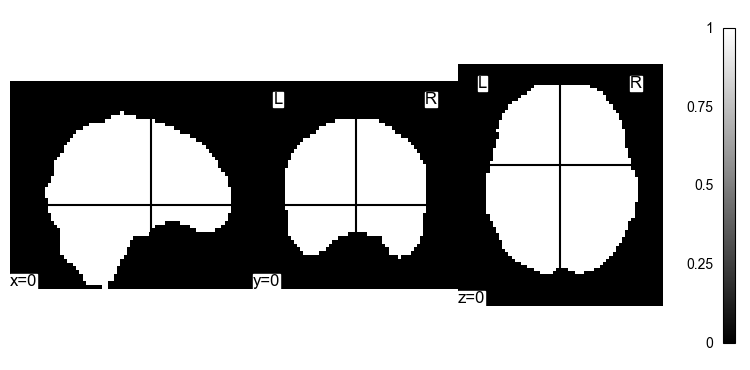

In [30]:
from nilearn import plotting
import nibabel as nib

# Quick view of anatomical image
plotting.view_img(mask)

# Static plots
plotting.plot_anat(mask)
plotting.show()

# Plot specific slice
plotting.plot_img(mask, cut_coords=(0, 0, 0))
plotting.show()


In [31]:
boldref = nibabel.load("../Familiarity/sub-11/func/sub-11_task-morph_run-1_space-MNI152NLin2009cAsym_boldref.nii.gz")

In [32]:
boldref.shape

(65, 77, 55)

C:\Python310\lib\site-packages\numpy\_core\fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
C:\Users\ducat\AppData\Local\Temp\ipykernel_21856\1448153368.py:5: UserWarning: Casting data from int32 to float32
  plotting.view_img(boldref)
C:\Python310\lib\site-packages\nilearn\plotting\image\utils.py:130: RuntimeWarning: overflow encountered in scalar subtract
  ptp = 0.5 * (vmax - vmin)


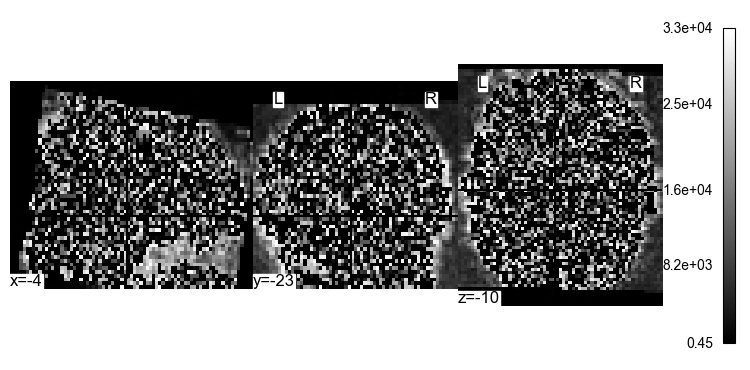

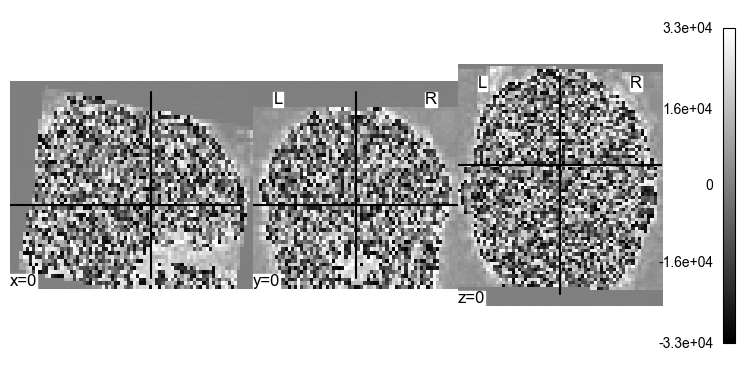

In [33]:
from nilearn import plotting
import nibabel as nib

# Quick view of anatomical image
plotting.view_img(boldref)

# Static plots
plotting.plot_anat(boldref)
plotting.show()

# Plot specific slice
plotting.plot_img(boldref, cut_coords=(0, 0, 0))
plotting.show()


In [34]:
boldref_no_mni = nibabel.load("../Familiarity/sub-11/func/sub-11_task-morph_run-1_boldref.nii.gz")

C:\Python310\lib\site-packages\numpy\_core\fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
C:\Users\ducat\AppData\Local\Temp\ipykernel_21856\2159243705.py:5: UserWarning: Casting data from int32 to float32
  plotting.view_img(boldref_no_mni)
C:\Python310\lib\site-packages\nilearn\plotting\image\utils.py:130: RuntimeWarning: overflow encountered in scalar subtract
  ptp = 0.5 * (vmax - vmin)
C:\Users\ducat\AppData\Local\Temp\ipykernel_21856\2159243705.py:8: UserWarning: Casting data from int32 to float32
  plotting.plot_anat(boldref_no_mni)


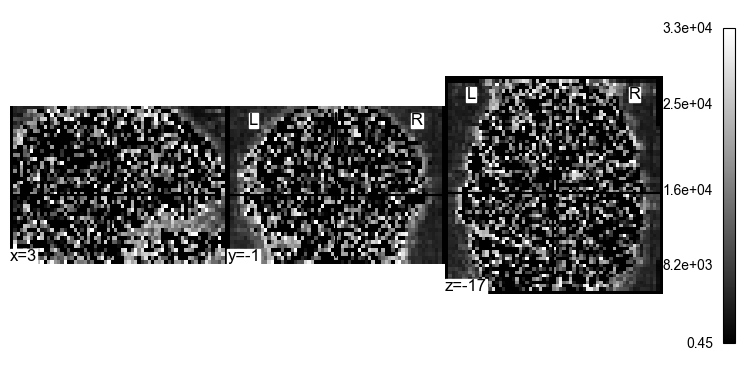

C:\Users\ducat\AppData\Local\Temp\ipykernel_21856\2159243705.py:12: UserWarning: Casting data from int32 to float32
  plotting.plot_img(boldref_no_mni, cut_coords=(0, 0, 0))


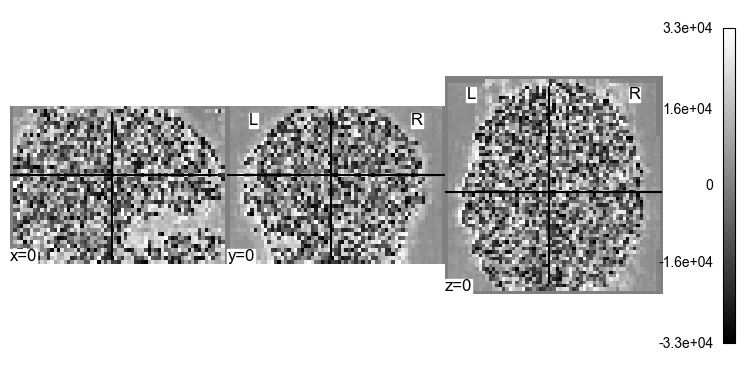

In [35]:
from nilearn import plotting
import nibabel as nib

# Quick view of anatomical image
plotting.view_img(boldref_no_mni)

# Static plots
plotting.plot_anat(boldref_no_mni)
plotting.show()

# Plot specific slice
plotting.plot_img(boldref_no_mni, cut_coords=(0, 0, 0))
plotting.show()


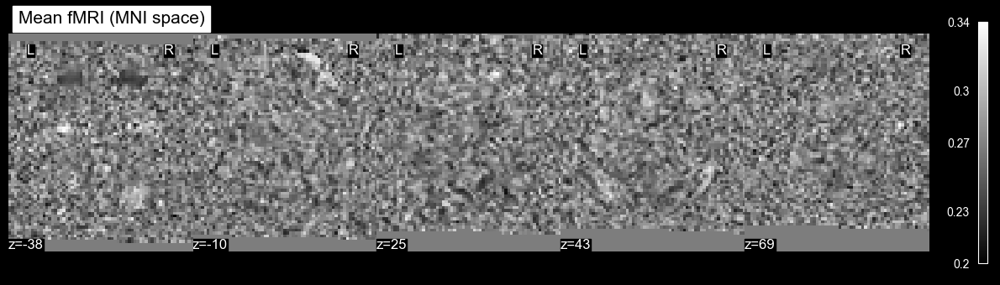

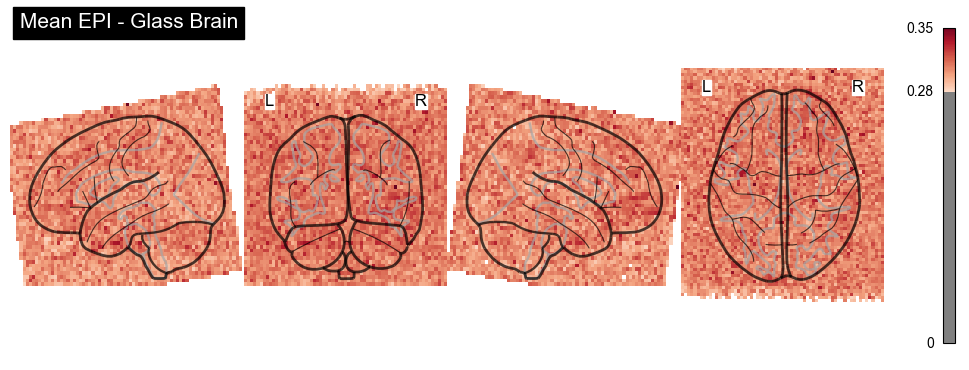

In [36]:
# Calculate and view mean image
mean_img = image.mean_img(x)

# Plot mean in MNI space
plotting.plot_epi(mean_img, title='Mean fMRI (MNI space)',
                  cut_coords=5, display_mode='z')
plt.show()

# Glass brain view
plotting.plot_glass_brain(mean_img, display_mode='lyrz',
                         colorbar=True, plot_abs=False,
                         title='Mean EPI - Glass Brain')
plt.show()


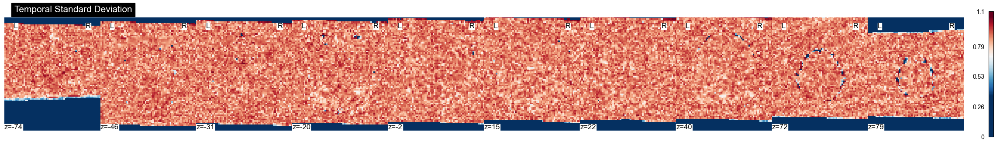

In [43]:
# Standard deviation across time (shows which regions vary most)
std_img = image.math_img('np.std(img, axis=3)', img=x)

plotting.plot_stat_map(std_img, bg_img=mean_img,
                       title='Temporal Standard Deviation',
                       cut_coords=10, display_mode='z',
                       colorbar=True)
plt.show()


In [60]:
from nilearn import datasets, masking
import nibabel as nib

# Load atlas (e.g., Harvard-Oxford)
atlas = datasets.fetch_atlas_harvard_oxford('cort-maxprob-thr25-2mm')
atlas_img = nib.load(atlas.filename).get_fdata()

# test = atlas_img[atlas_img != 0]
test = image.math_img('img[img != 0]', img=x)

# Extract time series from atlas regions
time_series = masking.apply_mask(x, test)

# Plot time series from multiple regions
fig, axes = plt.subplots(5, 1, figsize=(15, 10), sharex=True)

for i in range(5):
    roi_ts = time_series[:, i]
    axes[i].plot(roi_ts)
    axes[i].set_ylabel(f'ROI {i}')
    axes[i].grid(True)

axes[-1].set_xlabel('Timepoint (TR)')
fig.suptitle('Time Series from Different ROIs')
plt.tight_layout()
plt.show()


[fetch_atlas_harvard_oxford] Dataset found in C:\Users\ducat\nilearn_data\fsl

HeaderDataError: shape (48115314,) does not fit in dim datatype

In [1]:
import pandas as pd

labels = pd.read_csv("../labels/labels_11.csv")

In [2]:
labels["run time"].values

array([  1632,   5134,  11136,  16038,  25742,  29943,  35445,  38847,
        45250,  48551,  53153,  58839,  62540,  68942,  73244,  77646,
        82849,  88051,  92052, 102856, 106741, 112344, 115945, 121747,
       126249, 129851, 135352, 139555, 145657, 149858, 155361, 158562,
       164665, 169066, 173668, 178370, 183056, 187957, 192459, 203464,
       206564, 212751, 216652, 222538, 225840, 231041, 241328, 245029,
       251033, 255835, 260637, 265339, 269841, 274442, 278444, 284029,
       288614, 294317, 298619, 303421, 307522, 312407, 317810, 323195,
       327297, 341503, 346005, 350606, 355608, 360910, 366513, 370214,
       375017, 379418, 385421, 394024, 400227, 404728, 408130, 414433,
       419234, 422535, 427537, 433823, 438408, 442311, 446811, 452314,
       456816, 465819, 471322,   1337,   6039,  10540,  14742,  20444,
        25147,  29649,  35450,  38952,  44938,  54741,  59544,  62945,
        68648,  72449,  78651,  87655,  96858, 101561, 105763, 112248,
      

In [10]:
x.shape[3]

204

In [11]:
len(labels[labels["run"] == 1]["run time"].values)

91

In [12]:
x.header.get_zooms()[3] * x.shape[3]

np.float32(489.49948)

In [13]:
labels[labels["run"] == 1]["run time"].values[-1] / 1000

np.float64(471.322)

In [14]:
x.header.get_zooms()


(np.float32(3.0), np.float32(3.0), np.float32(3.6), np.float32(2.3995073))

In [15]:
import numpy as np
times = np.arange(0, x.shape[3] * x.header.get_zooms()[3], x.header.get_zooms()[3])

In [16]:
times * 1000

array([     0.        ,   2399.50728416,   4799.01456833,   7198.52185249,
         9598.02913666,  11997.53642082,  14397.04370499,  16796.55098915,
        19196.05827332,  21595.56555748,  23995.07284164,  26394.58012581,
        28794.08740997,  31193.59469414,  33593.1019783 ,  35992.60926247,
        38392.11654663,  40791.6238308 ,  43191.13111496,  45590.63839912,
        47990.14568329,  50389.65296745,  52789.16025162,  55188.66753578,
        57588.17481995,  59987.68210411,  62387.18938828,  64786.69667244,
        67186.2039566 ,  69585.71124077,  71985.21852493,  74384.7258091 ,
        76784.23309326,  79183.74037743,  81583.24766159,  83982.75494576,
        86382.26222992,  88781.76951408,  91181.27679825,  93580.78408241,
        95980.29136658,  98379.79865074, 100779.30593491, 103178.81321907,
       105578.32050323, 107977.8277874 , 110377.33507156, 112776.84235573,
       115176.34963989, 117575.85692406, 119975.36420822, 122374.87149239,
       124774.37877655, 1

In [17]:
x.shape[3]

204

In [18]:
df_run = labels[labels["run"] == 1]

In [19]:
df_run

,run,trial,global time,run time,morph level,couple,response,response time
0,1,1,803644,1632,45,3,1,694.0
1,1,2,807146,5134,75,7,1,676.0
2,1,3,813148,11136,55,1,1,3263.0
3,1,4,818050,16038,55,6,0,NaN
4,1,5,827754,25742,5,5,0,NaN
...,...,...,...,...,...,...,...,...
86,1,87,1248823,446811,45,9,1,619.0
87,1,88,1254326,452314,95,4,1,596.0
88,1,89,1258828,456816,25,7,0,NaN
89,1,90,1267831,465819,85,2,1,644.0


In [20]:
times_df = pd.DataFrame({'target_time': np.astype(times * 1000, np.int64)})

In [21]:
times_df

,target_time
0,0
1,2399
2,4799
3,7198
4,9598
...,...
199,477501
200,479901
201,482300
202,484700


In [22]:
mri_df = pd.merge_asof(times_df, df_run,
                       left_on='target_time',
                       right_on='run time',
                       direction='backward')

In [23]:
mri_df

,target_time,run,trial,global time,run time,morph level,couple,response,response time
0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2399,1.0,1.0,803644.0,1632.0,45.0,3.0,1.0,694.0
2,4799,1.0,1.0,803644.0,1632.0,45.0,3.0,1.0,694.0
3,7198,1.0,2.0,807146.0,5134.0,75.0,7.0,1.0,676.0
4,9598,1.0,2.0,807146.0,5134.0,75.0,7.0,1.0,676.0
...,...,...,...,...,...,...,...,...,...
199,477501,1.0,91.0,1273334.0,471322.0,45.0,4.0,0.0,NaN
200,479901,1.0,91.0,1273334.0,471322.0,45.0,4.0,0.0,NaN
201,482300,1.0,91.0,1273334.0,471322.0,45.0,4.0,0.0,NaN
202,484700,1.0,91.0,1273334.0,471322.0,45.0,4.0,0.0,NaN


In [24]:
from stats import *


In [25]:
cur_mean, cur_std = compute_morph_scores(mri_df)


In [26]:
_, fitted_curve = fit_sigmoid(cur_mean)

np.percentile(fitted_curve, 25)

np.float64(0.05745134800542831)

In [27]:
find_inflexion(fitted_curve, threshold=0.25)

np.float64(0.4707207207207207)

In [28]:
"""run_volumes = concat_imgs([data[i]['nii'] for i in runs])
run_times = np.concatenate([data[i]['times'] for i in runs])
run_conditions = np.concatenate([data[i]['labels'] for i in runs])
run_masks = np.concatenate([data[i]['masks'] for i in runs])

mask = res['%02d' %subject][0].brain_mask

trial_types = [f'morph_{level}' for level in run_conditions]
valid_trials = []
for count in range(len(trial_types)):
    if couples_mask[count]:
        valid_trials += [f'good_{trial_types[count]}']
    else:
        valid_trials += [f'bad_{trial_types[count]}']"""


events = pd.DataFrame(
    {'onset': times,
     'duration': 2.5}
)


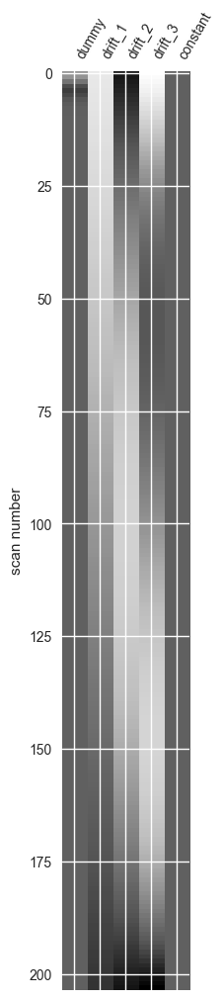

In [29]:
from nilearn.glm.first_level import FirstLevelModel

repetition_time = x.header.get_zooms()[3]
fmri_glm = FirstLevelModel(t_r=repetition_time,
          drift_model='polynomial',
          drift_order=3,
          signal_scaling=False,
          mask_img=mask,
          standardize=False,
          smoothing_fwhm=6,
          n_jobs=-1)

fmri_glm = fmri_glm.fit(x, events)

design_matrix = fmri_glm.design_matrices_[0]

from nilearn.plotting import plot_design_matrix
plot_design_matrix(design_matrix)
import matplotlib.pyplot as plt
plt.show()


In [29]:
confounds_df = pd.read_csv("../Familiarity/sub-11/func/sub-11_task-morph_run-1_desc-confounds_timeseries.tsv", delimiter='\t')




In [30]:
from nilearn import image, plotting

confound_columns = \
    ['a_comp_cor_00', 'a_comp_cor_01', 'a_comp_cor_02', 'a_comp_cor_03',
     'a_comp_cor_04', 'a_comp_cor_05', 'cosine00', 'cosine01', 'cosine02',
     'cosine03', 'cosine04', 'cosine05', 'trans_x', 'trans_y', 'trans_z',
     'rot_x', 'rot_y', 'rot_z']


In [31]:
x_cleaned = image.clean_img(x, confounds=confounds_df[confound_columns].values,
            detrend=True, low_pass=0.08, high_pass=0.009, t_r=x.header.get_zooms()[3])




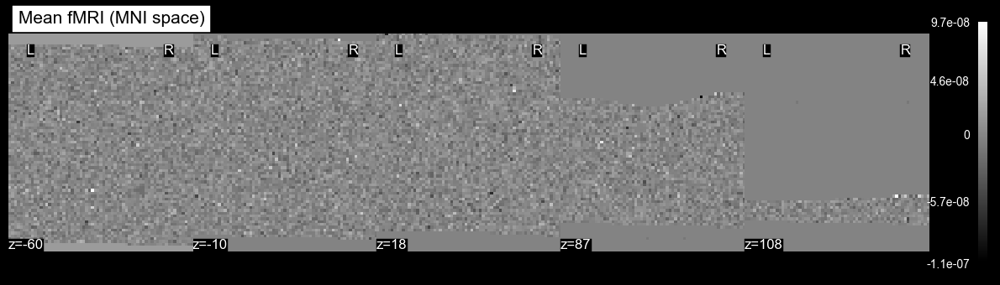

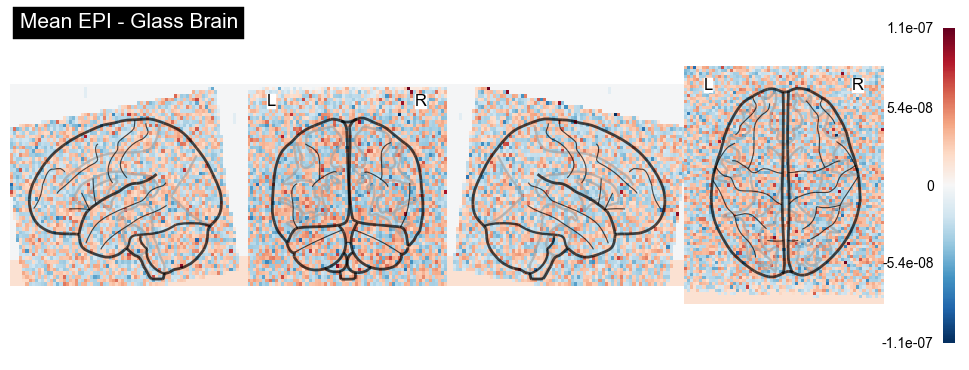

In [33]:
# Calculate and view mean image
mean_img_cleaned = image.mean_img(x_cleaned)

# Plot mean in MNI space
plotting.plot_epi(mean_img_cleaned, title='Mean fMRI (MNI space)',
                  cut_coords=5, display_mode='z')
plt.show()

# Glass brain view
plotting.plot_glass_brain(mean_img_cleaned, display_mode='lyrz',
                         colorbar=True, plot_abs=False,
                         title='Mean EPI - Glass Brain')
plt.show()


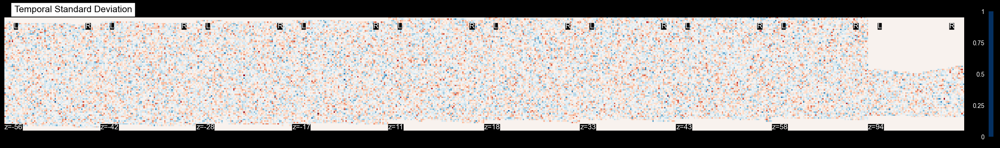

In [34]:
# Standard deviation across time (shows which regions vary most)
std_img_cleaned = image.math_img('np.std(img, axis=3)', img=x_cleaned)

plotting.plot_stat_map(std_img_cleaned, bg_img=mean_img_cleaned,
                       title='Temporal Standard Deviation',
                       cut_coords=10, display_mode='z',
                       colorbar=True)
plt.show()


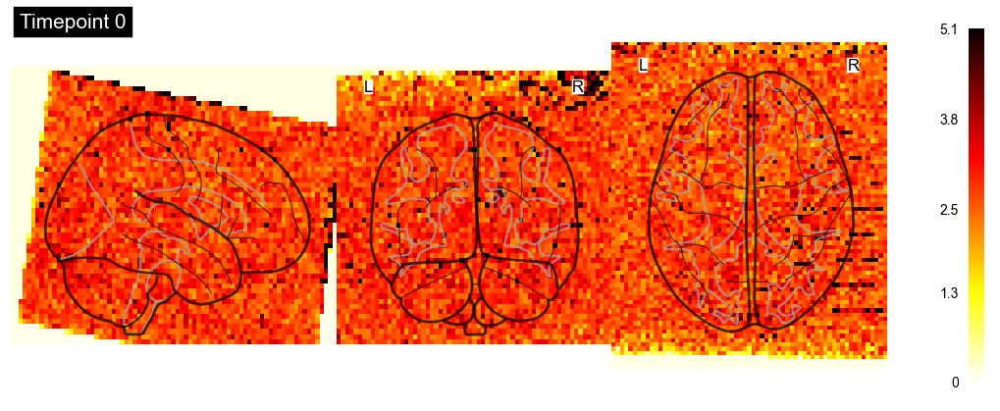

In [35]:
from nilearn import plotting, image
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(10, 4))

def animate(frame):
    plt.clf()
    vol = image.index_img(x_cleaned, frame)
    plotting.plot_glass_brain(vol, threshold=None,
                             title=f'Timepoint {frame}',
                             figure=fig, colorbar=True)

ani = animation.FuncAnimation(fig, animate,
                             frames=50,
                             interval=200)

HTML(ani.to_jshtml())